## Load the data

In [0]:
import pickle

pickle_path = "/Workspace/Users/shalom2552@campus.technion.ac.il/project/parsed_dicts.pickle"
with open(pickle_path, "rb") as f:
    parsed_dicts = pickle.load(f)

In [0]:
len(parsed_dicts)

Out[2]: 76187

## Length of about

In [0]:
import pickle
from pyspark.sql import SparkSession
spark = SparkSession.builder.getOrCreate()

pickle_path = "/Workspace/Users/shalom2552@campus.technion.ac.il/project/student_df.pickle"
with open(pickle_path, "rb") as f:
    pickleRdd = pickle.load(f)

student_df = spark.createDataFrame(pickleRdd)

In [0]:
student_df.display()

id,position,about,education_degree,education_field,education_title,educations_details,experience_company,experience_description,experience_positions_description,experience_positions_title,experience_positions_subtitle,employed
%D0%BC%D0%B8%D0%BB%D0%B0-%D0%B6%D0%B8%D1%85%D0%B0%D1%80%D0%B5%D0%B2%D0%B0-b26965115,Student at ABC,null,,,,null,,,,,,0
%D7%90%D7%99%D7%95%D7%91-%D7%9C%D7%99%D7%9C-a131a2a7,Student at University of Haifa,null,,,,null,,,,,,0
%D8%A7%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B1%D9%85%D8%A7%D8%AD%D9%8A-963647b3,Student at Universitas Ahmad Dahlan,null,,,,null,,,,,,0
%D8%B2%D8%A8%D9%86-%D8%A7%D9%84%D8%AC%D8%B4%D8%B9%D9%85%D9%8A-%D8%A3%D8%A8%D9%88-%D8%B3%D8%B9%D8%AF-99322548,Student at Springfield College,null,,,,null,,,,,,0
%D8%B9-%D9%80%D9%80%D9%80%D9%80%D9%80%D9%80%D8%A8%D8%AF%D8%A7%D9%84%D9%84%D9%87-%D8%A7%D9%84%D9%80%D9%80%D9%80-%D8%A7%D9%84%D8%B9%D9%86%D8%B2%D9%8A-a9748760,Student at UCAL,null,,,,null,,,,,,0
%D9%85%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B5%D8%A7%D9%84%D8%AD-b4b6a43b,Student at WKU,null,,,,null,,,,,,0
%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-r3s3-%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-9101104a,Student at Los Angeles Trade Technical College,null,,,,null,,,,,,0
%E4%B8%80%E5%93%B2-%E8%8B%8F-024048181,Student,null,Bachelor's degree,Hospitality Business,Michigan State University - Eli Broad College of Business,Michigan State University - Eli Broad College of Business,,,,,,0
%E5%98%89%E7%94%A6-%E5%8F%B6-7a10b7129,null,"Jiasu was born in Xuzhou, China. He studied photography in Sichuan University of Media and Communications, and then moved to Los Angeles to learn Filmmaking in New York Film Academy. During his studies at The New York Film Academy, Jiasu has wrote and directed several short films, such as Pasta, Love Story, Hotline. Meanwhile, he works hard making other films, music videos and advertisements. Jiasu Ye possesses excellent leadership, organization and coordination skills. He has editing film interviews and written movie reviews to publish in the entertainment section of Chinese Tencent Network since the year 2015.",Bachelor of Fine Arts (BFA),Filmmaking,"New York Film Academy, Los Angeles","New York Film Academy, Los Angeles",,,,,,0
%E5%98%89%E8%94%9A-%E9%82%B9-8b282568,Student at none,null,,,,null,,,,,,0


In [0]:
from pyspark.sql.functions import length, when, col

student_df = student_df.withColumn("about_length", length(student_df["about"]))
student_df = student_df.withColumn("about_length", when(col("about_length").isNull(), 0).otherwise(col("about_length")))
student_df.select('id', 'about', 'about_length').display()

id,about,about_length
%D0%BC%D0%B8%D0%BB%D0%B0-%D0%B6%D0%B8%D1%85%D0%B0%D1%80%D0%B5%D0%B2%D0%B0-b26965115,null,0
%D7%90%D7%99%D7%95%D7%91-%D7%9C%D7%99%D7%9C-a131a2a7,null,0
%D8%A7%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B1%D9%85%D8%A7%D8%AD%D9%8A-963647b3,null,0
%D8%B2%D8%A8%D9%86-%D8%A7%D9%84%D8%AC%D8%B4%D8%B9%D9%85%D9%8A-%D8%A3%D8%A8%D9%88-%D8%B3%D8%B9%D8%AF-99322548,null,0
%D8%B9-%D9%80%D9%80%D9%80%D9%80%D9%80%D9%80%D8%A8%D8%AF%D8%A7%D9%84%D9%84%D9%87-%D8%A7%D9%84%D9%80%D9%80%D9%80-%D8%A7%D9%84%D8%B9%D9%86%D8%B2%D9%8A-a9748760,null,0
%D9%85%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B5%D8%A7%D9%84%D8%AD-b4b6a43b,null,0
%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-r3s3-%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-9101104a,null,0
%E4%B8%80%E5%93%B2-%E8%8B%8F-024048181,null,0
%E5%98%89%E7%94%A6-%E5%8F%B6-7a10b7129,"Jiasu was born in Xuzhou, China. He studied photography in Sichuan University of Media and Communications, and then moved to Los Angeles to learn Filmmaking in New York Film Academy. During his studies at The New York Film Academy, Jiasu has wrote and directed several short films, such as Pasta, Love Story, Hotline. Meanwhile, he works hard making other films, music videos and advertisements. Jiasu Ye possesses excellent leadership, organization and coordination skills. He has editing film interviews and written movie reviews to publish in the entertainment section of Chinese Tencent Network since the year 2015.",619
%E5%98%89%E8%94%9A-%E9%82%B9-8b282568,null,0


## Skills

In [0]:
skills_list = []
employed_list = []
ids = []
for id, parsed_dict in parsed_dicts.items():
    
    if "Skills" in parsed_dict.keys():
        
        skills = parsed_dict["Skills"]
        employed = parsed_dict["employed"]

        if skills is not None:
            if len(skills) > 0:
                ids.append(id)
                employed_list.append(employed)
                skills_list.append(skills)


Out[16]: ['%E5%AD%90%E6%96%87-%E7%99%BD-84b60a134',
 '%E7%A8%94%E7%94%9F-%E9%87%91%E4%B8%B8-83a79b19a',
 '%E7%B4%AB%E6%9B%A6-%E9%AD%8F-2a0701220',
 '%E8%90%8C-%E6%9D%8E-bb9235133',
 '%c3%b6zlem-sayg%c4%b1-birg%c3%bcn-a1463721',
 '%e5%98%89%e7%bf%af-%e4%b8%81%e4%b8%81-678a27171',
 '-jake-henry',
 '-mattwilson-',
 '-savana-berhane-',
 'a%C3%AFnoa-cuadrado-626399218',
 'aagamvora',
 'aajah-hunter-8027aa11a',
 'aalanah-valentine-bb423a127',
 'aalim-abdullah-05b63490',
 'aaliyah-h-8074a41a7',
 'aareeb11',
 'aaron-acuna-5200491b2',
 'aaron-butwinick-8a7509179',
 'aaron-o-halloran-515065219',
 'aaron-pocatko-372828249',
 'aaron-sprague-71970862',
 'aaronnguyen4thewin',
 'aasta-keren-rodriguez',
 'aayush-panchal-4744b7167',
 'abarksdale',
 'abby-blagg-01bbb7222',
 'abdtarazi',
 'abdulaziz-almaimony-425723190',
 'abdullah-maghfuri-0612b612b',
 'abigail-elizarraraz-9a9257248',
 'abigail-johnson-081127248',
 'abigail-kemske-43117413',
 'abigail-plankenhorn',
 'abigailmicheals',
 'abraham-barr-ei-

In [0]:
len(skills_list)

Out[11]: 34392

In [0]:
from collections import Counter

# Flatten the skills_list into a single list
flattened_skills = [skill for sublist in skills_list for skill in sublist]

splited_skills_list = []
# Split each skill by space
for skill in flattened_skills:
    skills = skill.split(" ")
    for splited_string in skills:
        if splited_string != "and":
            splited_skills_list.append(splited_string.lower())

In [0]:
skills_flatten_and_split = flattened_skills + splited_skills_list

# Count the frequency of each skill
skill_counts = Counter(skills_flatten_and_split)

# Get the top common skills
top_common_skills = skill_counts.most_common(25)

# Display the histogram
for skill, count in top_common_skills:
    print(skill, count)

management 4890
development 2445
communication 2405
leadership 1989
design 1836
skills 1660
analysis 1572
data 1504
customer 1399
research 1278
Communication 1264
microsoft 1256
service 1255
writing 1223
planning 1197
Leadership 1139
marketing 1129
project 942
teaching 886
of 877
education 858
learning 849
business 799
social 767
team 766


In [0]:
# Count the frequency of each skill
skill_counts = Counter(flattened_skills)

# Get the top common skills
top_common_skills = skill_counts.most_common(25)

# Display the histogram
for skill, count in top_common_skills:
    print(skill, count)

Communication 1264
Leadership 1139
Customer Service 672
Teamwork 576
Python 482
Teaching 472
Marketing 429
Project Management 413
Sales 403
Writing 364
Research 341
Management 323
Collaboration 318
Microsoft Word 314
Java 293
Organization 290
Curriculum Development 281
Customer service 280
Problem Solving 268
Public Speaking 250
Microsoft Office 239
Problem-solving 238
SQL 236
Data Analysis 230
Time Management 227


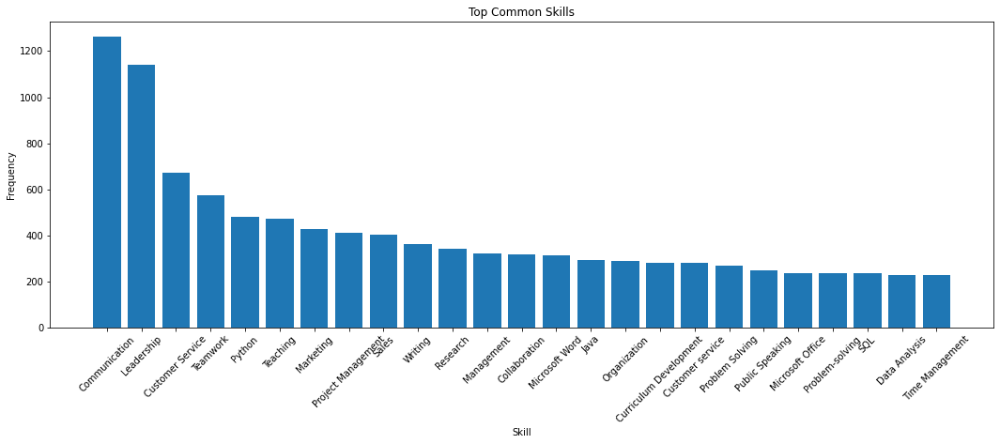

In [0]:
import matplotlib.pyplot as plt

# Visualize the histogram
labels, counts = zip(*top_common_skills)
plt.figure(figsize=(18, 6))
plt.bar(labels, counts)
plt.xlabel('Skill')
plt.ylabel('Frequency')
plt.title('Top Common Skills')
plt.xticks(rotation=45)
plt.show()

## Education field

In [0]:
education_field_list = []

for parsed_dict in parsed_dicts.values():
    
    if "Field of Education and Degree" in parsed_dict.keys():
        field = parsed_dict["Field of Education and Degree"]
        if field is not None and field != 'None':
            education_field_list.append(field)


In [0]:
len(education_field_list)

Out[20]: 15484

In [0]:
education_field_list

Out[21]: ['Photography',
 'Beijing Jiaotong University, Finance (Major change), Computer and Information Technology (Initial Major), Degree not mentioned',
 "Sociology, Bachelor's degree",
 'CSSE',
 'Master of Science in Electrical and Electronics Engineering',
 'PhD in Educational Psychology',
 'Computer Science, Minor in Mathematics',
 'Bachelor of Science in Journalism from the University of Florida',
 'Supply Chain Operations Management with minors in Information Systems, Business Analytics, and Spanish',
 'B.S. in Advertising at Texas Tech University',
 'Counseling (Degree not specified)',
 'Not mentioned',
 'Thunderbird School of Global Management, Masters of Global Business',
 'University of California, Los Angeles School of Law, Juris Doctor',
 "Bachelor's in Mechanical Engineering at the University of Mumbai",
 'Business Management, New River Community College (in progress)',
 'Communication Sciences and Disorders',
 'Audio/Video Production, Cincinnati State',
 'Computer Scien

In [0]:
histogram = {}
for field in education_field_list:
    if type(field) is not str:
        continue
    if field not in histogram.keys():
        histogram[field] = 1    
    else:
        histogram[field] += 1

In [0]:
top_15_histogram = sorted(histogram.items(), key=lambda x: x[1], reverse=True)[:15]
top_15_histogram

Out[23]: [('Not mentioned', 391),
 ('Computer Science', 111),
 ('Mechanical Engineering', 78),
 ('Business Administration', 39),
 ('Accounting', 38),
 ('None mentioned', 36),
 ('Chemistry (Degree not specified)', 34),
 ('Finance', 34),
 ('Chemistry', 31),
 ('Marketing', 28),
 ('None provided', 27),
 ('Nursing', 27),
 ('MBA', 27),
 ('Electrical Engineering', 24),
 ('Business', 23)]

## Education Details (University name)


In [0]:
from pyspark.sql.functions import col, split, explode

# Split the educations_details column by comma
split_educations = student_df.withColumn("split_educations", split(col("educations_details"), ", "))

# Explode the split_educations column into separate rows
exploded_educations = split_educations.select(explode(col("split_educations")).alias("education"))

# Count the occurrences of each education
education_counts = exploded_educations.groupBy("education").count()

# Sort the education_counts in descending order
sorted_education_counts = education_counts.orderBy(col("count").desc())

# Display the top 15 education counts
sorted_education_counts.display(15)

education,count
University of California,1568
California State University,1001
Arizona State University,736
Texas A&M University,676
University of Florida,544
University of Central Florida,514
Penn State University,492
The University of Texas at Austin,469
Northeastern University,469
The Ohio State University,459


## Position

In [0]:
# Split the positions column by comma
split_positions = student_df.withColumn("split_positions", split(col("position"), ", "))

# Explode the split_positions column into separate rows
exploded_positions = split_positions.select(explode(col("split_positions")).alias("position"))

# Count the occurrences of each position
position_counts = exploded_positions.groupBy("position").count()

# Sort the position_counts in descending order
sorted_position_counts = position_counts.orderBy(col("count").desc())

# Display the top 15 position counts
sorted_position_counts.limit(15).display()

position,count
Student at University of California,1722
Student,1710
Student at California State University,694
Student at Arizona State University,612
Student at University of Phoenix,554
Los Angeles,531
Student at Texas A&M University,487
Student at Penn State University,435
Student at The Ohio State University,430
Student at University of Central Florida,394


/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 32854 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 32004 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 32752 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 31185 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Glyph 25216 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/databricks/python/lib/python3.9/site-packages/matplotlib/backends/backend_agg.py:240: RuntimeWarning: Gl

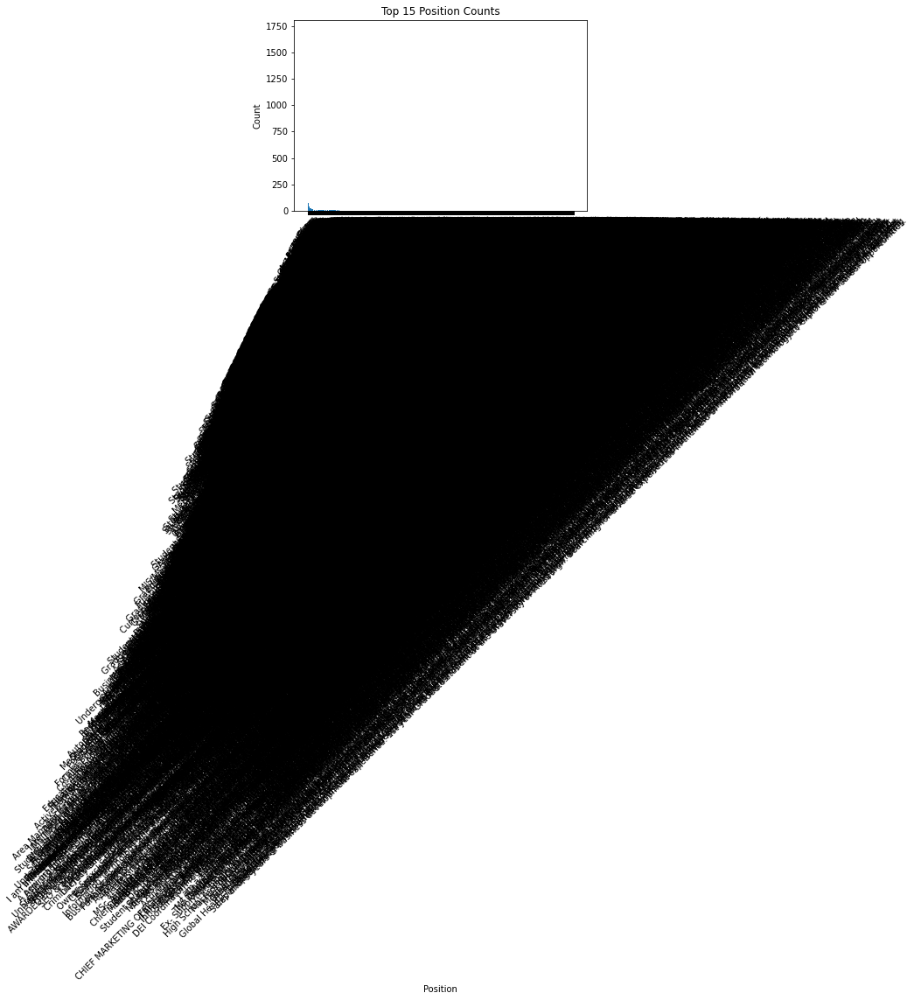

In [0]:
import matplotlib.pyplot as plt

# Extract the position and count columns from sorted_position_counts
positions = sorted_position_counts.select("position").rdd.flatMap(lambda x: x).collect()
counts = sorted_position_counts.select("count").rdd.flatMap(lambda x: x).collect()

# Create a bar plot of position counts
plt.bar(positions, counts)
plt.xlabel("Position")
plt.ylabel("Count")
plt.title("Top 15 Position Counts")
plt.xticks(rotation=45)
plt.show()

## 

## Level of Degree

In [0]:
# Split the education_degree column by comma
split_education_degree = student_df.withColumn("split_education_degree", split(col("education_degree"), ", "))

# Explode the split_education_degree column into separate rows
exploded_education_degree = split_education_degree.select(explode(col("split_education_degree")).alias("education_degree"))

# Count the occurrences of each education degree
education_degree_counts = exploded_education_degree.groupBy("education_degree").count()

# Sort the education_degree_counts in descending order
sorted_education_degree_counts = education_degree_counts.orderBy(col("count").desc())

# Remove the first row from sorted_education_degree_counts
sorted_education_degree_counts = sorted_education_degree_counts.filter(sorted_education_degree_counts["education_degree"] != sorted_education_degree_counts.first()["education_degree"])

# Display the top 15 education degree counts
sorted_education_degree_counts.limit(15).display()

education_degree,count
Bachelor's degree,18762
Bachelor of Science - BS,11729
Bachelor of Arts - BA,7200
Master's degree,5947
High School Diploma,5476
Associate's degree,4176
Master of Science - MS,4047
Bachelor of Business Administration - BBA,3862
Doctor of Philosophy - PhD,2735
Bachelor of Arts (B.A.),2579


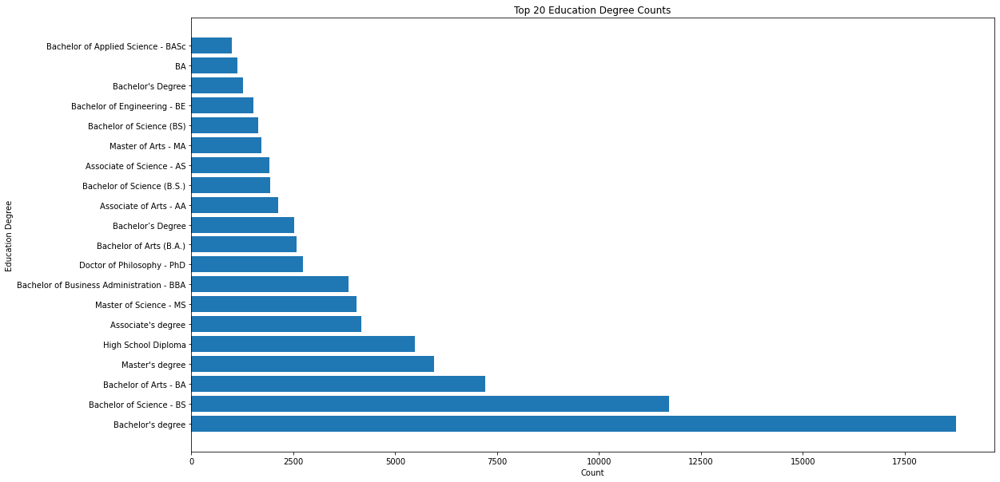

In [0]:
# Extract the education degrees and their counts from sorted_education_degree_counts
education_degrees = sorted_education_degree_counts.select("education_degree").rdd.flatMap(lambda x: x).collect()[:20]
counts = sorted_education_degree_counts.select("count").rdd.flatMap(lambda x: x).collect()[:20]

# Create a bar plot of the education degree counts
plt.figure(figsize=(18, 10))
plt.barh(education_degrees, counts)
plt.xlabel("Count")
plt.ylabel("Education Degree")
plt.title("Top 20 Education Degree Counts")
plt.show()

## Explore

In [0]:
student_df.display()

id,position,about,education_degree,education_field,education_title,educations_details,experience_company,experience_description,experience_positions_description,experience_positions_title,experience_positions_subtitle,employed,about_length
%D0%BC%D0%B8%D0%BB%D0%B0-%D0%B6%D0%B8%D1%85%D0%B0%D1%80%D0%B5%D0%B2%D0%B0-b26965115,Student at ABC,null,,,,null,,,,,,0,0
%D7%90%D7%99%D7%95%D7%91-%D7%9C%D7%99%D7%9C-a131a2a7,Student at University of Haifa,null,,,,null,,,,,,0,0
%D8%A7%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B1%D9%85%D8%A7%D8%AD%D9%8A-963647b3,Student at Universitas Ahmad Dahlan,null,,,,null,,,,,,0,0
%D8%B2%D8%A8%D9%86-%D8%A7%D9%84%D8%AC%D8%B4%D8%B9%D9%85%D9%8A-%D8%A3%D8%A8%D9%88-%D8%B3%D8%B9%D8%AF-99322548,Student at Springfield College,null,,,,null,,,,,,0,0
%D8%B9-%D9%80%D9%80%D9%80%D9%80%D9%80%D9%80%D8%A8%D8%AF%D8%A7%D9%84%D9%84%D9%87-%D8%A7%D9%84%D9%80%D9%80%D9%80-%D8%A7%D9%84%D8%B9%D9%86%D8%B2%D9%8A-a9748760,Student at UCAL,null,,,,null,,,,,,0,0
%D9%85%D8%AD%D9%85%D8%AF-%D8%A7%D9%84%D8%B5%D8%A7%D9%84%D8%AD-b4b6a43b,Student at WKU,null,,,,null,,,,,,0,0
%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-r3s3-%E2%99%AB%E2%98%86%C6%B9%CC%B5%CC%A1%D3%9D%CC%B5%CC%A8%CC%84%CA%92%E2%99%A5%E2%99%A5%E1%83%A6%E2%99%A5%E1%83%A6-9101104a,Student at Los Angeles Trade Technical College,null,,,,null,,,,,,0,0
%E4%B8%80%E5%93%B2-%E8%8B%8F-024048181,Student,null,Bachelor's degree,Hospitality Business,Michigan State University - Eli Broad College of Business,Michigan State University - Eli Broad College of Business,,,,,,0,0
%E5%98%89%E7%94%A6-%E5%8F%B6-7a10b7129,null,"Jiasu was born in Xuzhou, China. He studied photography in Sichuan University of Media and Communications, and then moved to Los Angeles to learn Filmmaking in New York Film Academy. During his studies at The New York Film Academy, Jiasu has wrote and directed several short films, such as Pasta, Love Story, Hotline. Meanwhile, he works hard making other films, music videos and advertisements. Jiasu Ye possesses excellent leadership, organization and coordination skills. He has editing film interviews and written movie reviews to publish in the entertainment section of Chinese Tencent Network since the year 2015.",Bachelor of Fine Arts (BFA),Filmmaking,"New York Film Academy, Los Angeles","New York Film Academy, Los Angeles",,,,,,0,619
%E5%98%89%E8%94%9A-%E9%82%B9-8b282568,Student at none,null,,,,null,,,,,,0,0


## Get new data

In [0]:
skills_list = []
employed_list = []
ids = []

skills_list_df = []
for id, parsed_dict in parsed_dicts.items():
    
    if "Skills" in parsed_dict.keys():
        
        skills = parsed_dict["Skills"]
        employed = parsed_dict["employed"]

        if skills is not None:
            if len(skills) > 0:
                ids.append(id)
                employed_list.append(employed)
                skills_list.append(skills)

                skills_list_df.append([id, skills])


In [0]:
from pyspark.sql.types import ArrayType, IntegerType, StringType, StructType, StructField

lst = skills_list_df
schema = StructType([
    StructField("id", StringType(), True),
    StructField("skills", ArrayType(StringType()), True)
])

skills_df = spark.createDataFrame(lst, schema)
skills_df.printSchema()
skills_df.show()


root
 |-- id: string (nullable = true)
 |-- skills: array (nullable = true)
 |    |-- element: string (containsNull = true)

+--------------------+--------------------+
|                  id|              skills|
+--------------------+--------------------+
|%E5%AD%90%E6%96%8...|[SPSS, Eviews, Bl...|
|%E7%A8%94%E7%94%9...|[Baseball, Sports...|
|%E7%B4%AB%E6%9B%A...|[Programming, Dat...|
|%E8%90%8C-%E6%9D%...|[computer archite...|
|%c3%b6zlem-sayg%c...|[Early Childhood ...|
|%e5%98%89%e7%bf%a...|[Bilingual commun...|
|         -jake-henry|[Time management,...|
|        -mattwilson-|[Mass Retail, Off...|
|    -savana-berhane-|     [Communication]|
|a%C3%AFnoa-cuadra...|[Communication, C...|
|           aagamvora|        [Management]|
|aajah-hunter-8027...|[Document draftin...|
|aalanah-valentine...|[Microsoft Office...|
|aalim-abdullah-05...|[Bader Charge Top...|
| aaliyah-h-8074a41a7|[Time Management,...|
|            aareeb11|[Web Development,...|
|aaron-acuna-52004...|[Data Entry (Exce

In [0]:
joined_df = student_df.select('id', 'position', 'education_field', 'employed').join(skills_df, 'id', 'left')
filtered_df = joined_df.filter((joined_df.skills.isNotNull()) | (joined_df.education_field != ''))
filtered_df = filtered_df.select('id', 'position', 'education_field', 'skills', 'employed')

In [0]:
filtered_df.display()

id,position,education_field,employed,skills
%F0%9F%8D%9Elee-likes-bread%F0%9F%8D%9E-b1b71a229,Student at Madison middle school,nvmhf mkjutdhytd,1,null
abigail-finn-78ab371b5,Student at West Virginia University,Forensic and Investigative Science,1,null
abigail-powell-50061a125,Graduate Student in Mental Health Counseling,"Mental Health Counseling/Counselor, Junior",1,null
achim-koso-thomas-199a721a8,Student at DEMATHA CATHOLIC HIGH SCHOOL,none,0,null
adam-rowbury-9a6b80207,null,"Human and Family Services, Certified Alcohol and Drug Counselor",1,"List(Teaching, Curriculum Development, Assessment, Leadership)"
aden-mccracken,null,,1,"List(Teaching, Curriculum Development, Educational Leadership, Student Engagement, Research, Lab Development, Assessment, Program Administration, Mentoring)"
adrienne-waisner-87aba3b2,Student at Eastern Michigan University,Communication and Media Studies,1,null
agnes-pommier-1a22a2104,null,"Business Administration and Management, General",1,"List(Teaching, Research, Curriculum Development, Student Advising, University Service)"
aidan-clark-b8bb091bb,Business Student-Athlete at Virginia Tech,"Business Administration and Management, General",1,null
alavi-hossain-8b685431,null,Public Health,0,null


In [0]:
import pickle

pickle_path = "/Workspace/Users/shalom2552@campus.technion.ac.il/project/students_skills_education_df.pickle"
with open(pickle_path, "wb") as f:
    pickle.dump(filtered_df.collect(), f)

In [0]:
import pickle
from pyspark.sql import SparkSession
spark = SparkSession.builder.getOrCreate()

pickle_path = "/Workspace/Users/shalom2552@campus.technion.ac.il/project/students_skills_education_df.pickle"
with open(pickle_path, "rb") as f:
    pickleRdd = pickle.load(f)

students_skills_education_df = spark.createDataFrame(pickleRdd)

In [0]:
students_skills_education_df.display()

id,position,education_field,skills,employed
%F0%9F%8D%9Elee-likes-bread%F0%9F%8D%9E-b1b71a229,Student at Madison middle school,nvmhf mkjutdhytd,null,1
abigail-finn-78ab371b5,Student at West Virginia University,Forensic and Investigative Science,null,1
abigail-powell-50061a125,Graduate Student in Mental Health Counseling,"Mental Health Counseling/Counselor, Junior",null,1
achim-koso-thomas-199a721a8,Student at DEMATHA CATHOLIC HIGH SCHOOL,none,null,0
adam-rowbury-9a6b80207,null,"Human and Family Services, Certified Alcohol and Drug Counselor","List(Teaching, Curriculum Development, Assessment, Leadership)",1
aden-mccracken,null,,"List(Teaching, Curriculum Development, Educational Leadership, Student Engagement, Research, Lab Development, Assessment, Program Administration, Mentoring)",1
adrienne-waisner-87aba3b2,Student at Eastern Michigan University,Communication and Media Studies,null,1
agnes-pommier-1a22a2104,null,"Business Administration and Management, General","List(Teaching, Research, Curriculum Development, Student Advising, University Service)",1
aidan-clark-b8bb091bb,Business Student-Athlete at Virginia Tech,"Business Administration and Management, General",null,1
alavi-hossain-8b685431,null,Public Health,null,0


In [0]:
students_skills_education_df.count()

Out[62]: 102402